In [1]:
import os
import shutil
from random import shuffle
from IPython.display import Audio
import PIL
import librosa #a python package for music and audio analysis. It provides the building blocks necessary to create music information retrieval systems.
import keras
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from keras.models import Sequential
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from keras.layers import Conv2D, Flatten, Dense, MaxPooling2D, Dropout

In [ ]:
!mkdir img_dataset\train\cat
!mkdir img_dataset\train\dog
!mkdir img_dataset\test\combined

In [2]:
def preprocessing_spectrogram(filename, path, savepath):
    x, sr = librosa.load(path + filename)
    x_stft = librosa.stft(x)
    x_db_version = librosa.amplitude_to_db(abs(x_stft))
    plt.figure(figsize=(14, 5))
    librosa.display.specshow(x_db_version, sr=sr, y_axis = 'hz')
    plt.ylabel('')
    plt.axis('off')
    file_name = filename.replace('.wav', '')
    plt.savefig(savepath+file_name, bbox_inches='tight', pad_inches=0)
    plt.close()

In [3]:
cat_train_path = 'cats_dogs/train/cat/'
for audio in os.listdir(cat_train_path):
    preprocessing_spectrogram(audio, cat_train_path, 'img_dataset/train/cat/')

In [4]:
dog_train_path = 'cats_dogs/train/dog/'
for audio in os.listdir(dog_train_path):
    preprocessing_spectrogram(audio, dog_train_path, 'img_dataset/train/dog/')

In [5]:
cat_test_path = 'cats_dogs/test/cat/'
for audio in os.listdir(cat_test_path):
    preprocessing_spectrogram(audio, cat_test_path, 'img_dataset/test/combined/')

In [6]:
dog_test_path = 'cats_dogs/test/dog/'
for audio in os.listdir(dog_test_path):
    preprocessing_spectrogram(audio, dog_test_path, 'img_dataset/test/combined/')

In [7]:
for audio in os.listdir(dog_test_path):
    display(Audio(dog_test_path+audio))

In [8]:
for audio in os.listdir(cat_test_path):
    display(Audio(cat_test_path+audio))

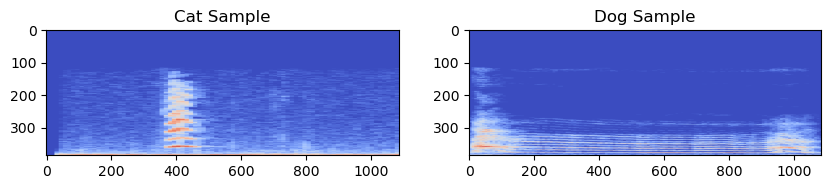

In [9]:
sample_cat_image = plt.imread('img_dataset/test/combined/cat_76.png')
sample_dog_image = plt.imread('img_dataset/test/combined/dog_barking_43.png')

figure, (ax1, ax2) = plt.subplots(1,2, figsize=(10, 2))
ax1.imshow(sample_cat_image)
ax1.set_title('Cat Sample')
ax2.imshow(sample_dog_image)
ax2.set_title('Dog Sample')
plt.show()

In [10]:
combined_test_dir = 'img_dataset/test/combined/'
combined_test_list = os.listdir(combined_test_dir)
shuffle(combined_test_list)
for entry in combined_test_list:
    print(entry)

dog_barking_112.png
cat_61.png
dog_barking_62.png
cat_86.png
dog_barking_89.png
cat_28.png
dog_barking_46.png
cat_66.png
dog_barking_45.png
dog_barking_99.png
dog_barking_78.png
cat_88.png
cat_144.png
cat_79.png
cat_58.png
cat_148.png
cat_85.png
cat_158.png
dog_barking_66.png
dog_barking_48.png
dog_barking_9.png
dog_barking_12.png
cat_3.png
cat_133.png
dog_barking_8.png
dog_barking_91.png
dog_barking_7.png
cat_57.png
dog_barking_54.png
cat_90.png
dog_barking_15.png
dog_barking_49.png
cat_135.png
dog_barking_43.png
dog_barking_3.png
cat_130.png
cat_14.png
cat_24.png
cat_126.png
dog_barking_44.png
cat_76.png
dog_barking_64.png
cat_56.png
dog_barking_82.png
dog_barking_73.png
cat_59.png
cat_143.png
dog_barking_59.png
cat_129.png
dog_barking_34.png
cat_67.png
cat_20.png
cat_42.png
cat_110.png
cat_115.png
cat_82.png
cat_112.png
cat_152.png
cat_137.png
cat_75.png
cat_36.png
dog_barking_19.png
cat_17.png
cat_29.png
dog_barking_90.png
dog_barking_24.png
cat_55.png


In [11]:
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

In [12]:
train_data = os.path.join('img_dataset/train')
test_data = os.path.join('img_dataset/test')

In [13]:
train_generator = train_datagen.flow_from_directory(train_data, target_size=(250, 250), batch_size=30, color_mode='rgb', shuffle=True, class_mode='binary')
test_generator = test_datagen.flow_from_directory(test_data, target_size=(250, 250), batch_size=30, color_mode='rgb', shuffle=True, class_mode='binary')

Found 210 images belonging to 2 classes.
Found 67 images belonging to 1 classes.


In [14]:
model = Sequential([Conv2D(40, (5, 5), activation='relu', input_shape=(250, 250, 3)),
                    MaxPooling2D(3, 3),
                    
                    Conv2D(80, (5, 5), activation='relu'),
                    MaxPooling2D(3, 3),
                    
                    Conv2D(160, (5, 5), activation='relu'),
                    MaxPooling2D(3, 3),
                    Flatten(),
                    
                    Dense(400, activation='tanh', kernel_initializer='normal'),
                    Dropout(0.3),
                    Dense(200, activation='tanh', kernel_initializer='normal'),
                    Dropout(0.3),
                    Dense(100, activation='tanh', kernel_initializer='normal'),
                    Dense(1, activation='sigmoid')
])

In [15]:
model.compile(optimizer='adamax', metrics=['accuracy'], loss='binary_crossentropy')

In [16]:
class Callback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs={}):
        if logs.get('accuracy') > 0.8999:
            self.model.stop_training = True

In [17]:
hist = model.fit(train_generator, epochs=20, validation_data=test_generator, batch_size=64, steps_per_epoch=210//64, validation_steps=67//64, callbacks=[Callback()])

Epoch 1/20
3/3 [==============================] - 4s 1s/step - loss: 1.0878 - accuracy: 0.4667 - val_loss: 0.1268 - val_accuracy: 1.0000
Epoch 2/20
3/3 [==============================] - 2s 864ms/step - loss: 0.8288 - accuracy: 0.5889 - val_loss: 0.4666 - val_accuracy: 1.0000
Epoch 3/20
3/3 [==============================] - 2s 758ms/step - loss: 0.6330 - accuracy: 0.6778 - val_loss: 0.5874 - val_accuracy: 0.9667
Epoch 4/20
3/3 [==============================] - 2s 747ms/step - loss: 0.6091 - accuracy: 0.6556 - val_loss: 0.3751 - val_accuracy: 1.0000
Epoch 5/20
3/3 [==============================] - 2s 744ms/step - loss: 0.6326 - accuracy: 0.5778 - val_loss: 0.4103 - val_accuracy: 1.0000
Epoch 6/20
3/3 [==============================] - 2s 753ms/step - loss: 0.5660 - accuracy: 0.6222 - val_loss: 0.5715 - val_accuracy: 0.5667
Epoch 7/20
3/3 [==============================] - 2s 772ms/step - loss: 0.5203 - accuracy: 0.7667 - val_loss: 0.4452 - val_accuracy: 0.7333
Epoch 8/20
3/3 [=======

In [18]:
def makeprediction(imagepath):
    img = image.load_img(imagepath, target_size=(250, 250, 3))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    
    images = np.vstack([x])
    classes = model.predict(images, batch_size=10)
    
    if classes.round() == 1:
        return 'dog'
    elif classes.round() == 0:
        return 'cat'

1/1 [==============================] - 0s 23ms/step
img_dataset/test/combined/cat_110.png - cat


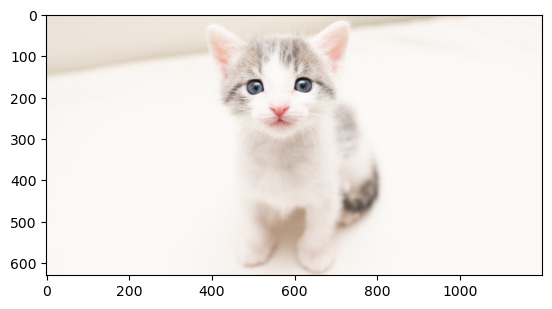

img_dataset/test/combined/cat_112.png - dog


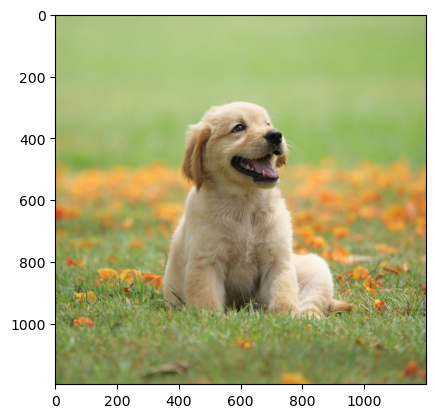

img_dataset/test/combined/cat_115.png - cat


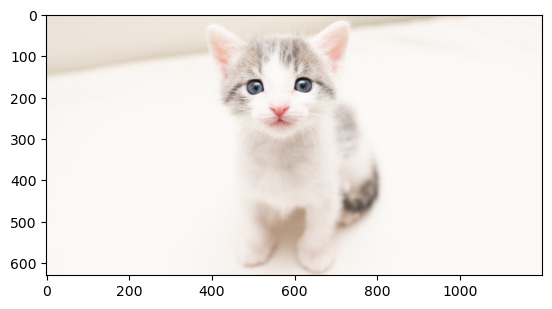

img_dataset/test/combined/cat_126.png - cat


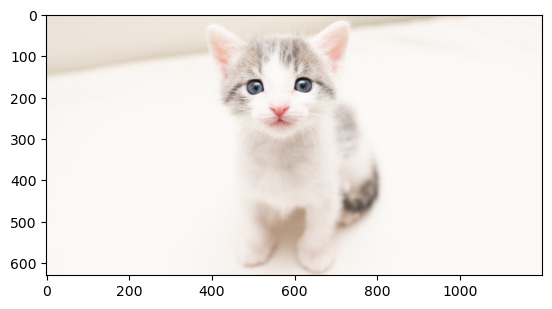

img_dataset/test/combined/cat_129.png - dog


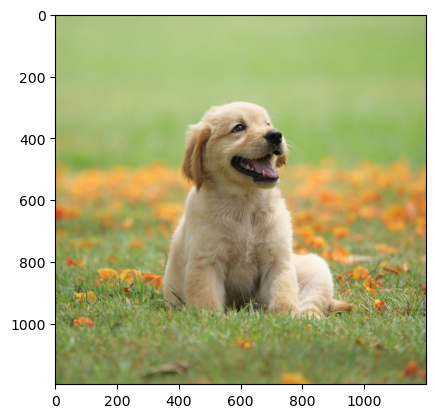

img_dataset/test/combined/cat_130.png - cat


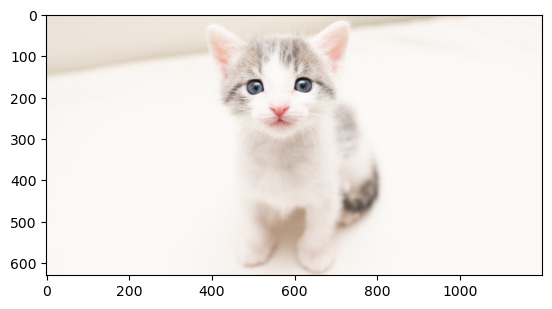

img_dataset/test/combined/cat_133.png - cat


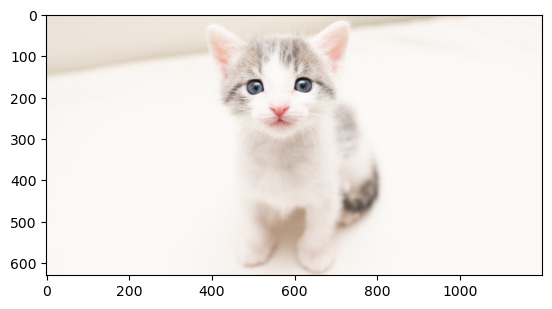

img_dataset/test/combined/cat_135.png - cat


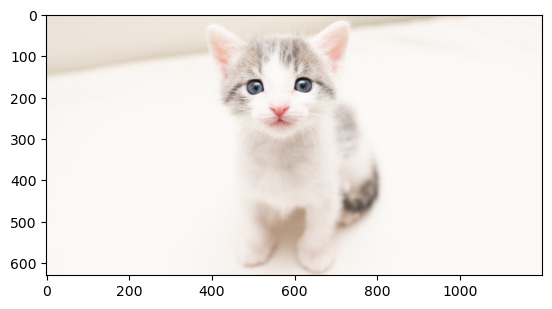

img_dataset/test/combined/cat_137.png - cat


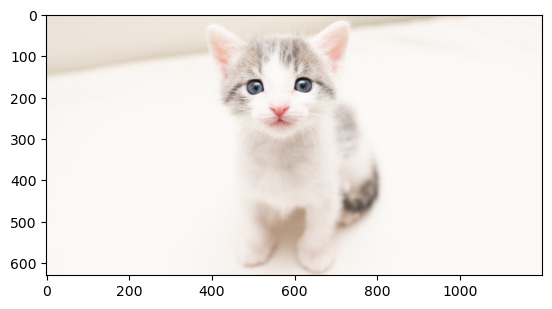

img_dataset/test/combined/cat_14.png - cat


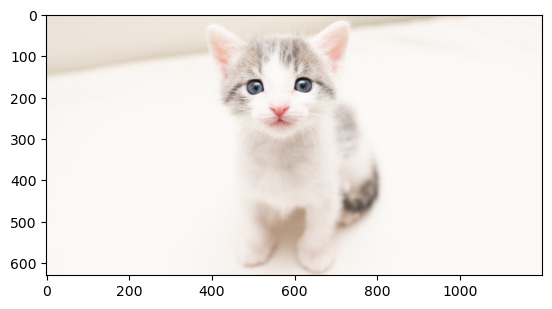

img_dataset/test/combined/cat_143.png - cat


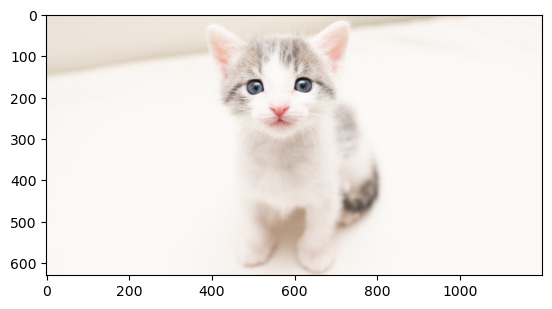

img_dataset/test/combined/cat_144.png - cat


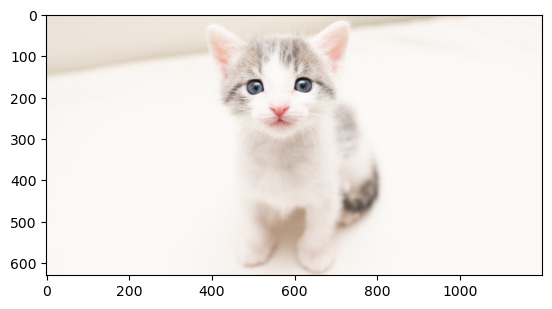

img_dataset/test/combined/cat_148.png - cat


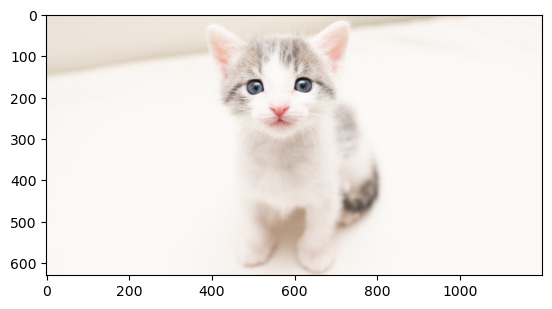

img_dataset/test/combined/cat_152.png - cat


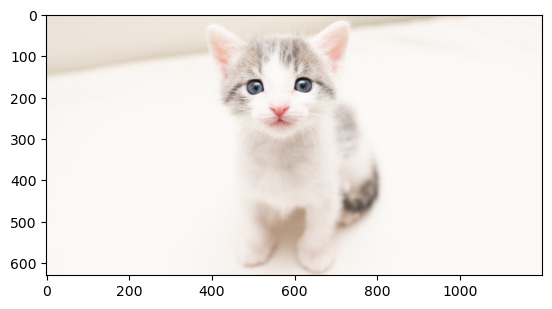

img_dataset/test/combined/cat_158.png - cat


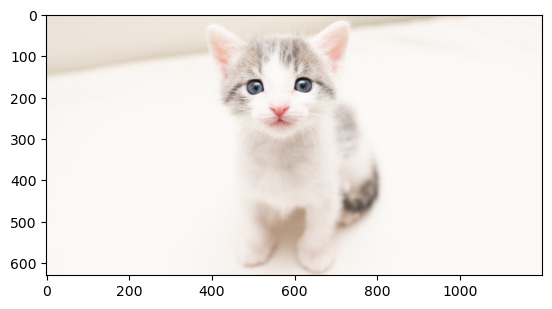

img_dataset/test/combined/cat_17.png - dog


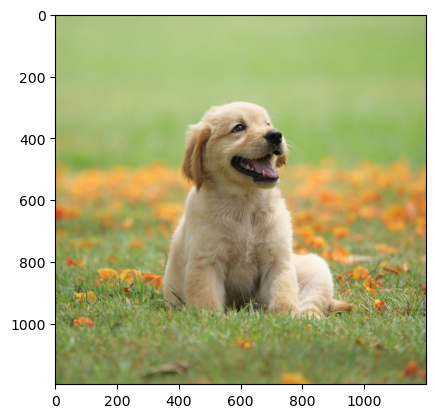

img_dataset/test/combined/cat_20.png - cat


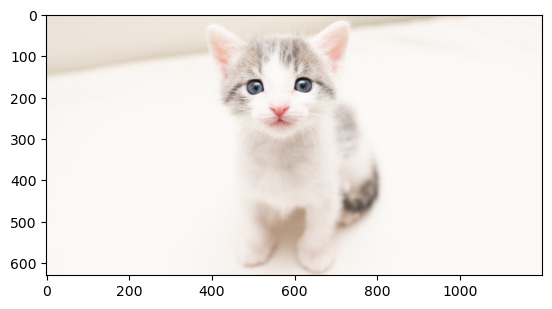

img_dataset/test/combined/cat_24.png - cat


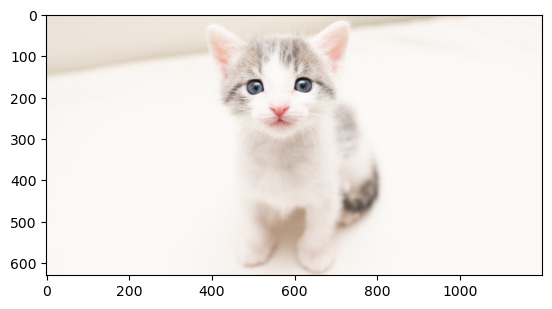

img_dataset/test/combined/cat_28.png - cat


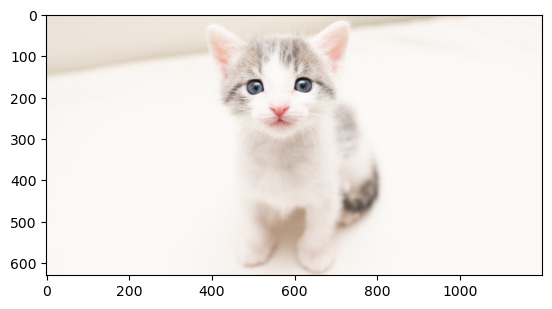

img_dataset/test/combined/cat_29.png - cat


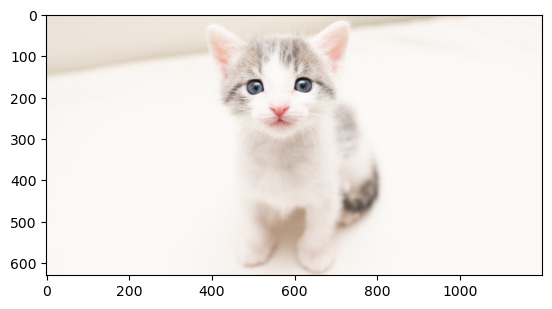

img_dataset/test/combined/cat_3.png - cat


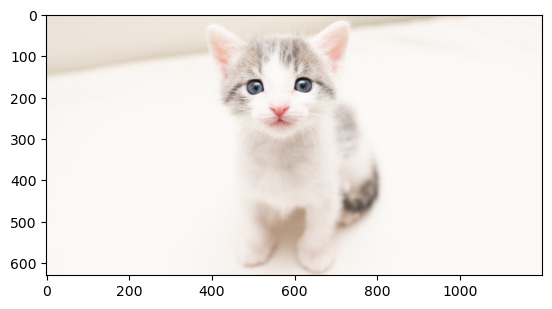

img_dataset/test/combined/cat_36.png - cat


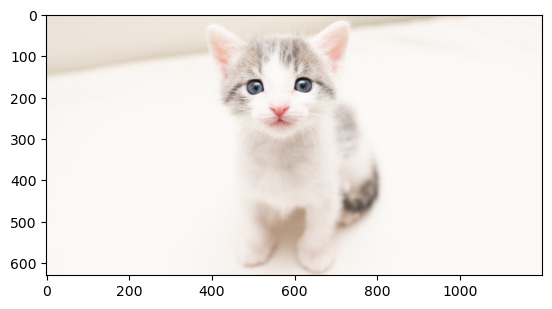

img_dataset/test/combined/cat_42.png - cat


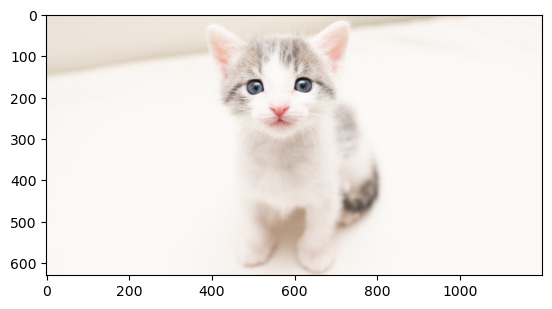

img_dataset/test/combined/cat_55.png - cat


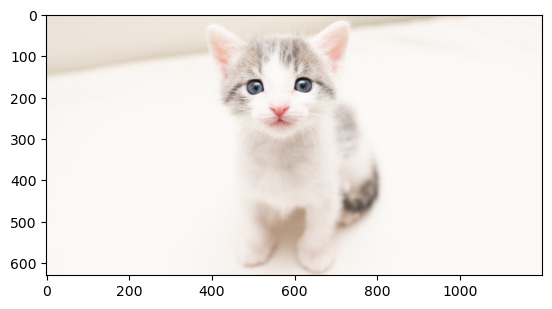

img_dataset/test/combined/cat_56.png - cat


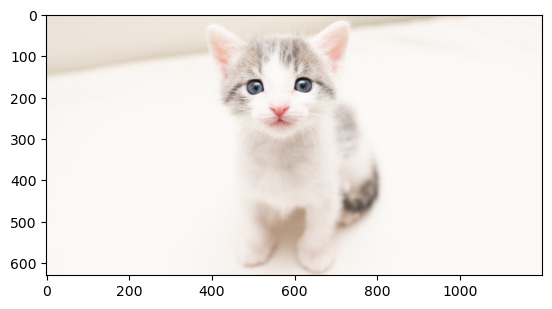

img_dataset/test/combined/cat_57.png - cat


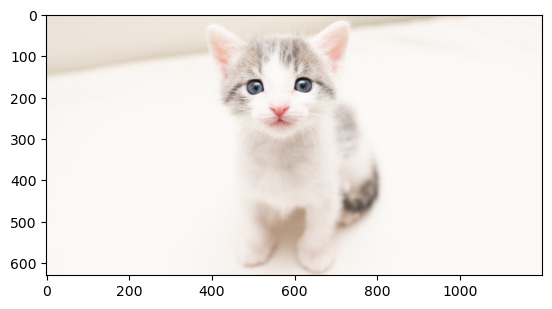

img_dataset/test/combined/cat_58.png - cat


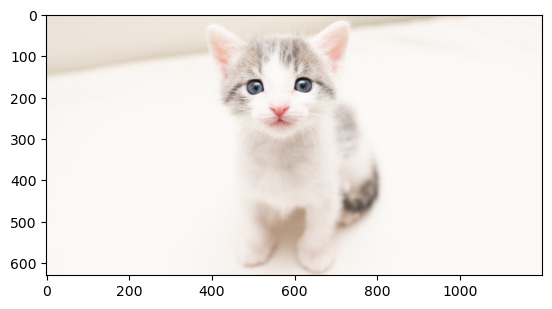

img_dataset/test/combined/cat_59.png - cat


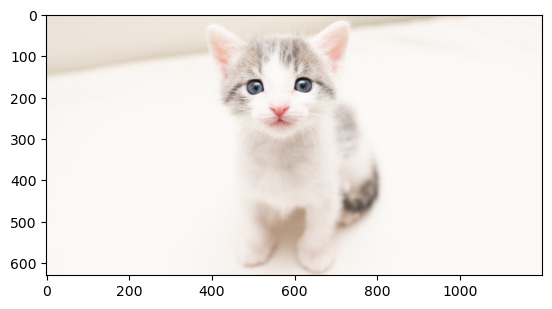

img_dataset/test/combined/cat_61.png - cat


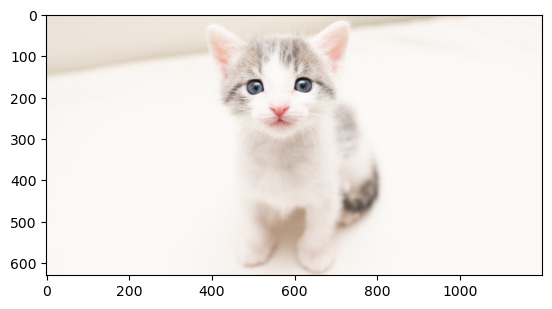

img_dataset/test/combined/cat_66.png - cat


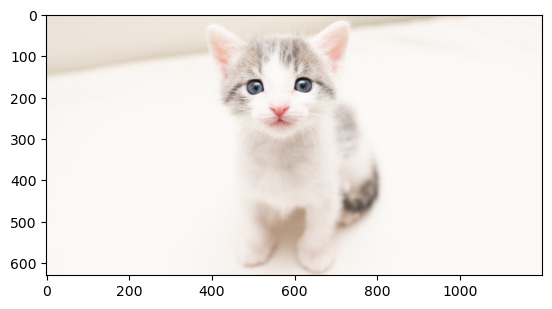

img_dataset/test/combined/cat_67.png - dog


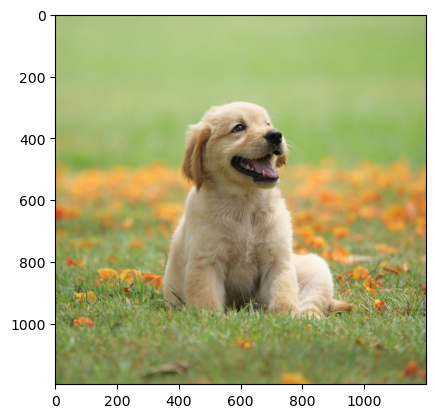

img_dataset/test/combined/cat_75.png - cat


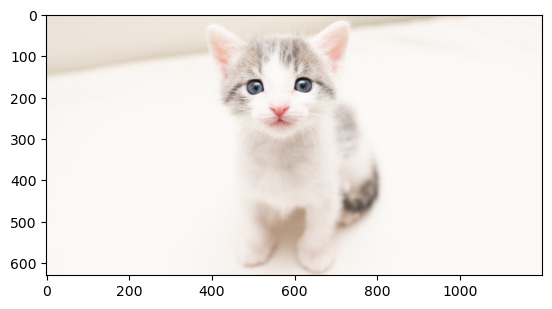

img_dataset/test/combined/cat_76.png - cat


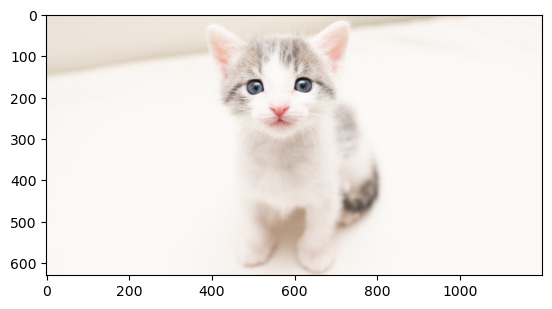

img_dataset/test/combined/cat_79.png - cat


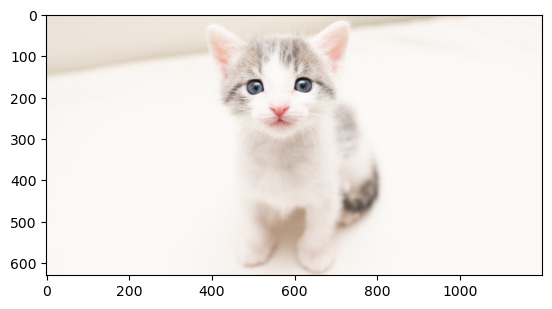

img_dataset/test/combined/cat_82.png - cat


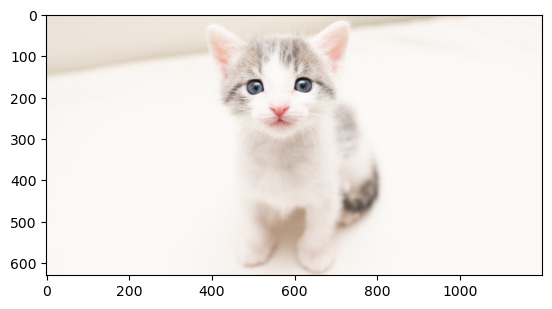

img_dataset/test/combined/cat_85.png - cat


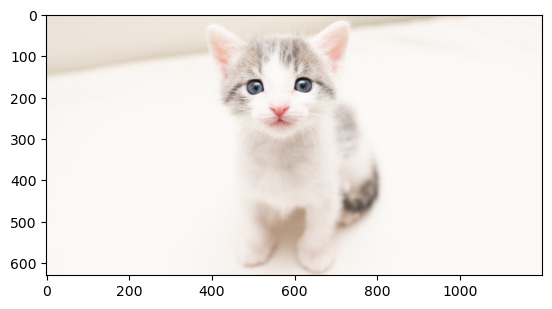

img_dataset/test/combined/cat_86.png - cat


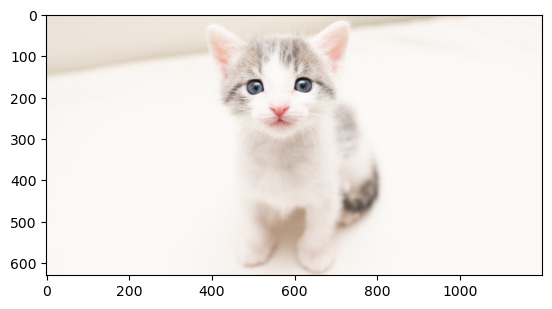

img_dataset/test/combined/cat_88.png - cat


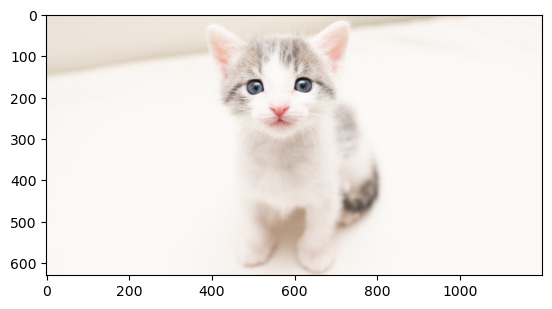

img_dataset/test/combined/cat_90.png - cat


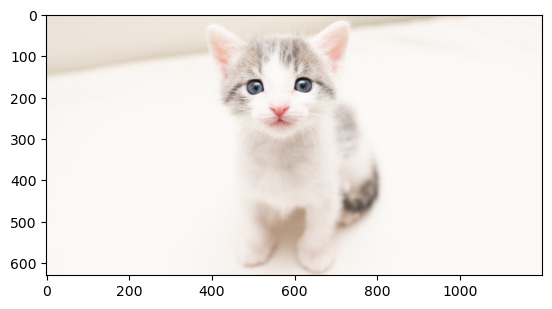

img_dataset/test/combined/dog_barking_112.png - cat


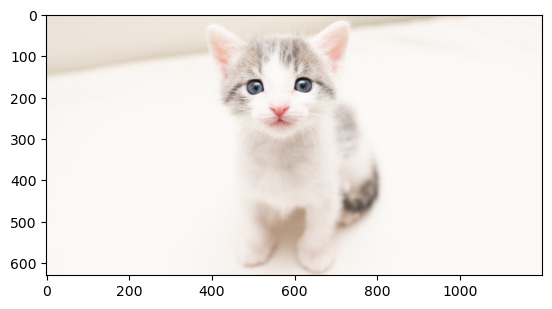

img_dataset/test/combined/dog_barking_12.png - dog


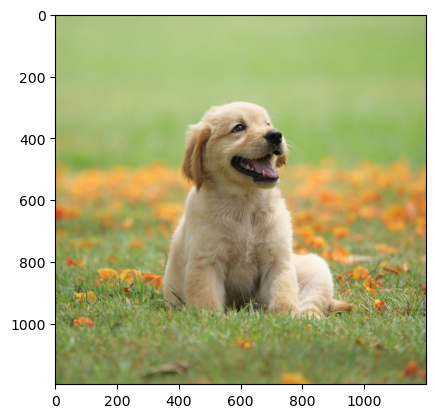

img_dataset/test/combined/dog_barking_15.png - dog


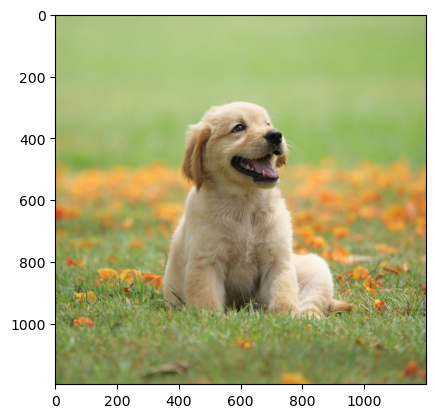

img_dataset/test/combined/dog_barking_19.png - dog


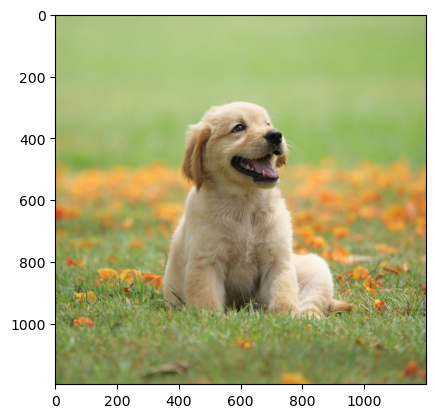

img_dataset/test/combined/dog_barking_24.png - dog


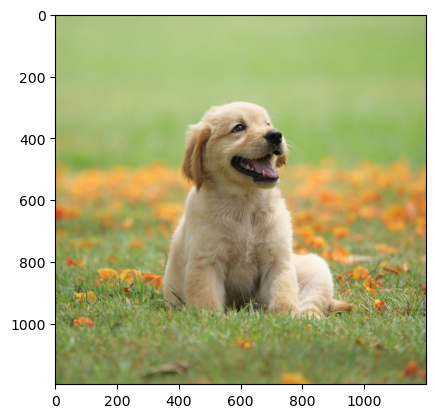

img_dataset/test/combined/dog_barking_3.png - cat


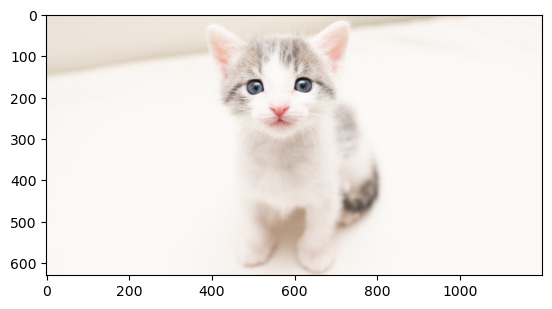

img_dataset/test/combined/dog_barking_34.png - dog


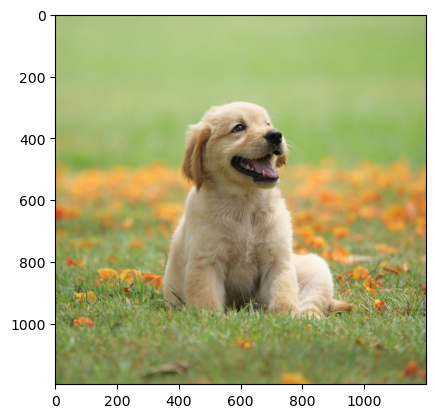

img_dataset/test/combined/dog_barking_43.png - dog


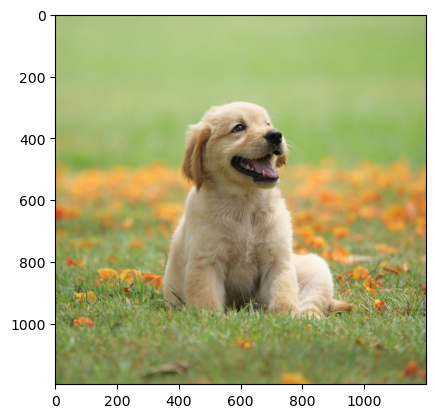

img_dataset/test/combined/dog_barking_44.png - dog


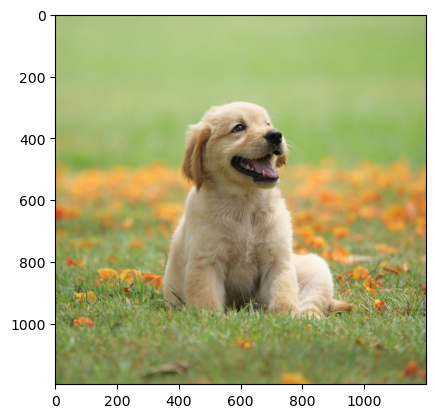

img_dataset/test/combined/dog_barking_45.png - dog


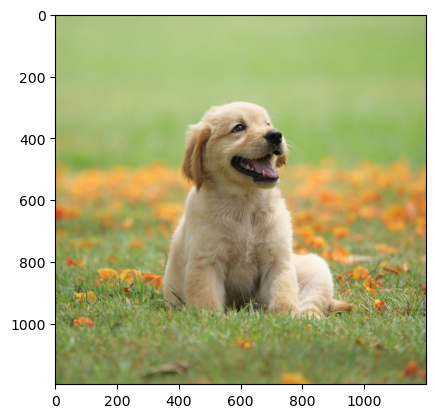

img_dataset/test/combined/dog_barking_46.png - dog


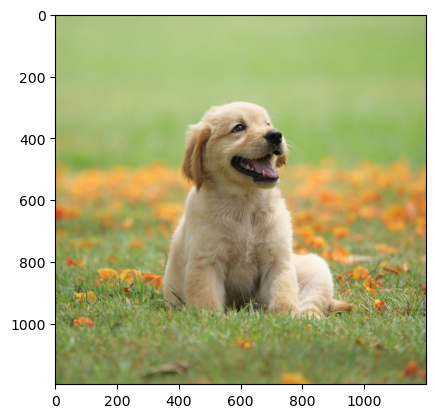

img_dataset/test/combined/dog_barking_48.png - dog


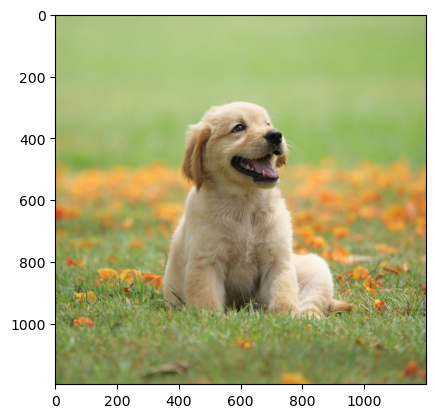

img_dataset/test/combined/dog_barking_49.png - dog


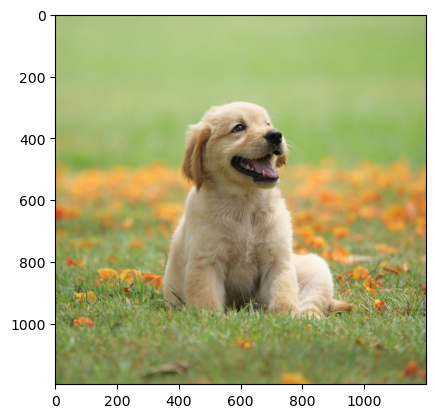

img_dataset/test/combined/dog_barking_54.png - dog


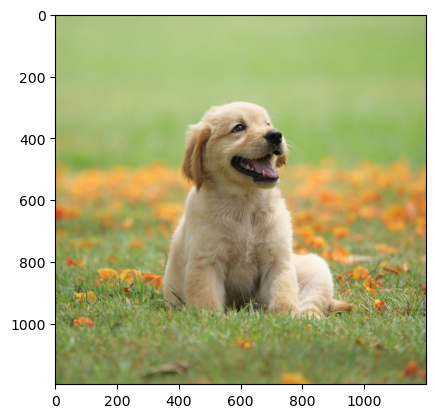

img_dataset/test/combined/dog_barking_59.png - dog


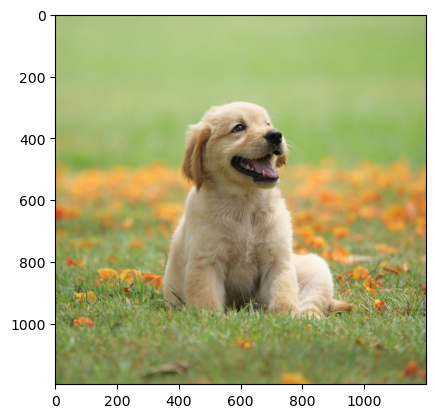

img_dataset/test/combined/dog_barking_62.png - dog


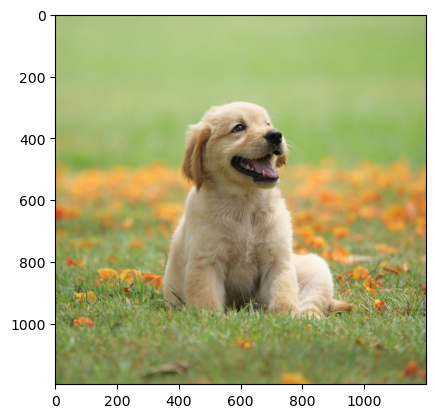

img_dataset/test/combined/dog_barking_64.png - dog


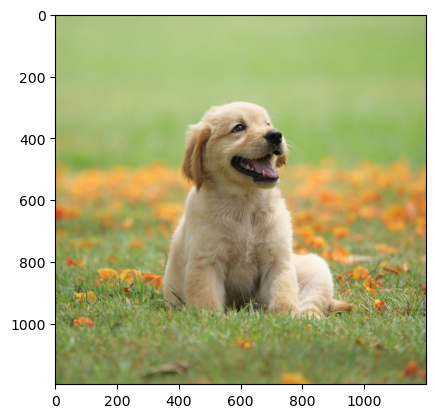

img_dataset/test/combined/dog_barking_66.png - dog


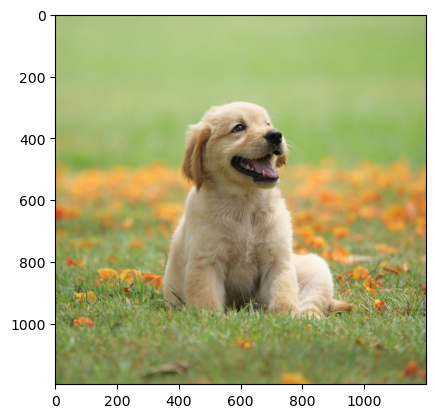

img_dataset/test/combined/dog_barking_7.png - cat


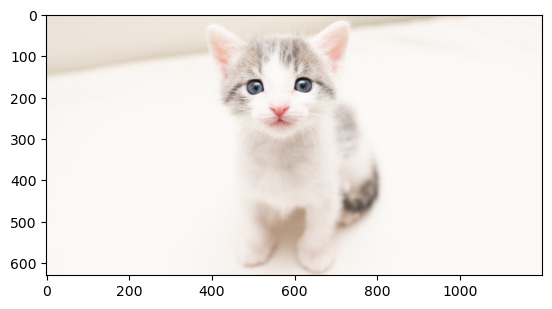

img_dataset/test/combined/dog_barking_73.png - dog


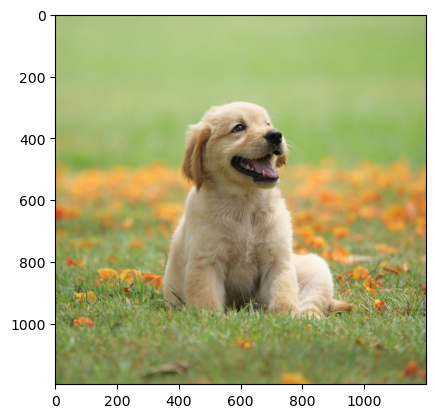

img_dataset/test/combined/dog_barking_78.png - dog


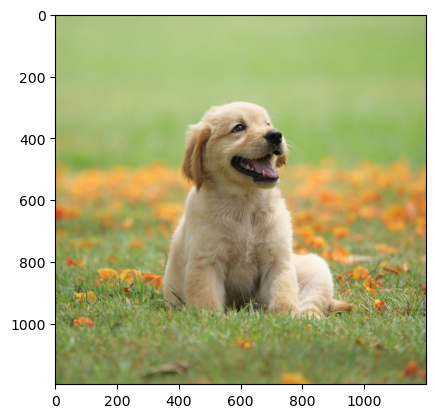

img_dataset/test/combined/dog_barking_8.png - cat


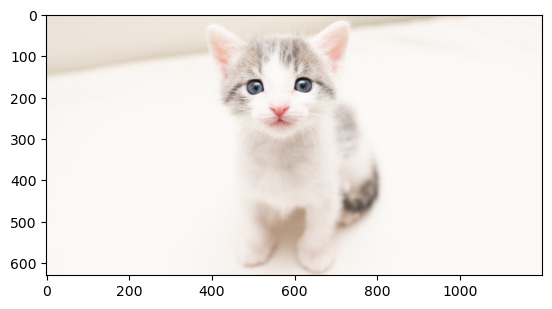

img_dataset/test/combined/dog_barking_82.png - dog


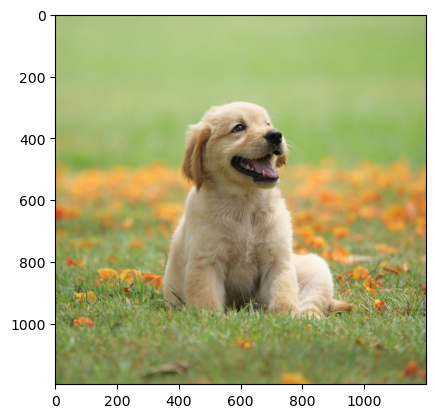

img_dataset/test/combined/dog_barking_89.png - cat


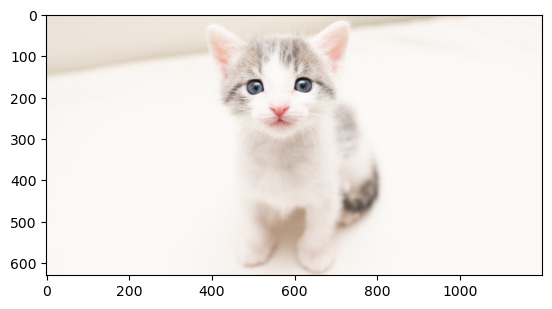

img_dataset/test/combined/dog_barking_9.png - cat


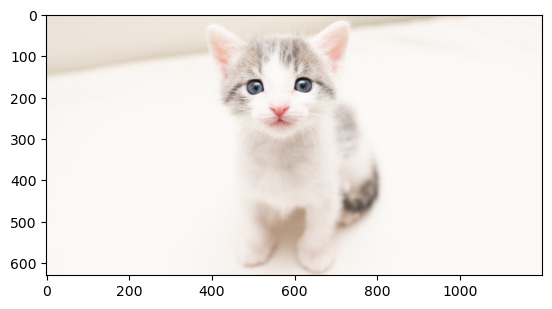

img_dataset/test/combined/dog_barking_90.png - dog


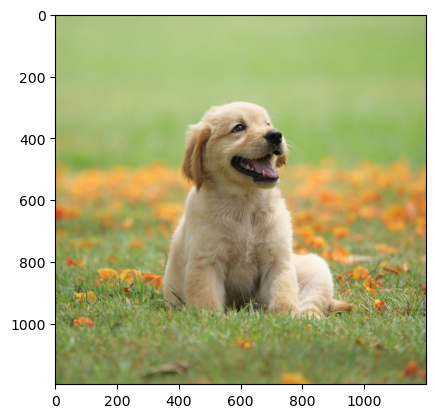

img_dataset/test/combined/dog_barking_91.png - dog


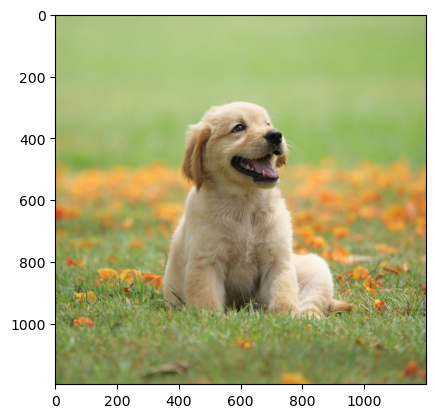

img_dataset/test/combined/dog_barking_99.png - cat


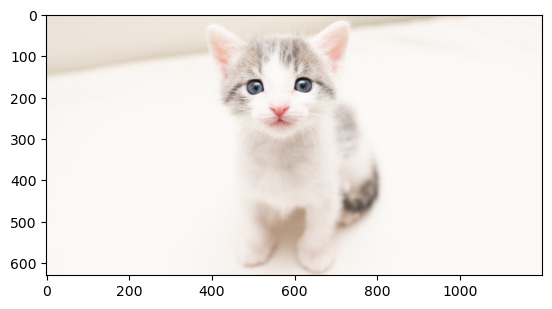

In [19]:
result = []
for entry in os.listdir(combined_test_dir):
    pathexample = combined_test_dir+entry
    result.append(pathexample + ' - ' + makeprediction(pathexample))

for entry in result:
    combined_path, _, prediction = entry.split()
    if prediction == 'dog':
        print(entry)
        img = PIL.Image.open('dogcatphoto/dog.jpg')
        plt.imshow(img)
        plt.show()
    else:
        print(entry)
        img = PIL.Image.open('dogcatphoto/cat.jpg')
        plt.imshow(img)
        plt.show()